# Phishing Detection Domain

Life Cycle of Machine Learning Project

1. Understanding the Problem Statement
2. Data Collection 
3. Data Checks to perfom
4. EDA(Exploratory Data Analysis)
5. Data Pre-Processing
6. Model Selection and Training
7. Model Evaluation
8. Choose best model


1) Problem Statement


2) Data Collection

* Data Source -"/kaggle/input/phishing-dataset-for-machine-learning/Phishing_Legitimate_full.csv"
* The data consists of 

2.1 Import Data and Required Packages

Importing Pandas , Numpy , Matplotlib ,Seaborn, and warings Library

In [38]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import statistics as stats
%matplotlib inline
import warnings
warnings.filterwarnings('ignore')

Import the CSV Data as Pandas DataFrame

In [10]:


# Use a raw string for the file path to avoid issues with backslashes
file_path = r"E:\Phishing_domain_detection\notebook\data\Phishing_Legitimate_full.csv"

# Read the CSV file
df = pd.read_csv(file_path)




Show Top 5 Records

In [11]:
df.head()

,id,NumDots,SubdomainLevel,PathLevel,UrlLength,NumDash,NumDashInHostname,AtSymbol,TildeSymbol,NumUnderscore,...,IframeOrFrame,MissingTitle,ImagesOnlyInForm,SubdomainLevelRT,UrlLengthRT,PctExtResourceUrlsRT,AbnormalExtFormActionR,ExtMetaScriptLinkRT,PctExtNullSelfRedirectHyperlinksRT,CLASS_LABEL
0,1,3,1,5,72,0,0,0,0,0,...,0,0,1,1,0,1,1,-1,1,1
1,2,3,1,3,144,0,0,0,0,2,...,0,0,0,1,-1,1,1,1,1,1
2,3,3,1,2,58,0,0,0,0,0,...,0,0,0,1,0,-1,1,-1,0,1
3,4,3,1,6,79,1,0,0,0,0,...,0,0,0,1,-1,1,1,1,-1,1
4,5,3,0,4,46,0,0,0,0,0,...,1,0,0,1,1,-1,0,-1,-1,1


Show Bottom 5 Records

In [12]:
df.tail()

,id,NumDots,SubdomainLevel,PathLevel,UrlLength,NumDash,NumDashInHostname,AtSymbol,TildeSymbol,NumUnderscore,...,IframeOrFrame,MissingTitle,ImagesOnlyInForm,SubdomainLevelRT,UrlLengthRT,PctExtResourceUrlsRT,AbnormalExtFormActionR,ExtMetaScriptLinkRT,PctExtNullSelfRedirectHyperlinksRT,CLASS_LABEL
9995,9996,3,1,1,50,0,0,0,0,0,...,0,0,0,1,1,-1,1,0,1,0
9996,9997,2,1,4,59,1,0,0,0,0,...,1,0,0,1,0,0,1,0,1,0
9997,9998,2,1,4,57,0,0,0,0,0,...,0,0,0,1,0,1,1,0,1,0
9998,9999,3,1,1,49,0,0,0,0,0,...,1,0,0,1,1,0,1,0,1,0
9999,10000,3,1,2,52,3,0,0,0,0,...,0,0,0,1,1,1,1,1,1,0


Shape Of the Dataset

In [13]:
df.shape

(10000, 50)


2.2  Dataset Information
The dataset contains 10,000 entries and 50 columns, each representing different features related to phishing and legitimate URLs. Below is a summary of each column and its type:

1. id: Unique identifier for each entry (int64).
2. NumDots: Number of dots in the URL (int64).
3. SubdomainLevel: Number of subdomains in the URL (int64).
4. PathLevel: Number of path levels in the URL (int64).
5. UrlLength: Length of the URL (int64).
6. NumDash: Number of dashes in the URL (int64).
7. NumDashInHostname: Number of dashes in the hostname (int64).
8. AtSymbol: Presence of "@" symbol in the URL (int64).
9. TildeSymbol: Presence of "~" symbol in the URL (int64).
10. NumUnderscore: Number of underscores in the URL (int64).
11. NumPercent: Number of percent (%) symbols in the URL (int64).
12. NumQueryComponents: Number of query components in the URL (int64).
13. NumAmpersand: Number of ampersands (&) in the URL (int64).
14. NumHash: Number of hash (#) symbols in the URL (int64).
15. NumNumericChars: Number of numeric characters in the URL (int64).
16. NoHttps: Indicates whether HTTPS is absent in the URL (int64).
17. RandomString: Indicates presence of random strings in the URL (int64).
18. IpAddress: Indicates presence of an IP address in the URL (int64).
19. DomainInSubdomains: Indicates if the domain appears in subdomains (int64).
20. DomainInPaths: Indicates if the domain appears in paths (int64).
21. HttpsInHostname: Indicates if HTTPS appears in the hostname (int64).
22. HostnameLength: Length of the hostname (int64).
23. PathLength: Length of the path in the URL (int64).
24. QueryLength: Length of the query string in the URL (int64).
25. DoubleSlashInPath: Indicates presence of double slashes in the path (int64).
26. NumSensitiveWords: Number of sensitive words in the URL (int64).
27. EmbeddedBrandName: Indicates presence of a brand name embedded in the URL (int64).
28. PctExtHyperlinks: Percentage of external hyperlinks (float64).
29. PctExtResourceUrls: Percentage of external resource URLs (float64).
30. ExtFavicon: Indicates if an external favicon is used (int64).
31. InsecureForms: Indicates if forms are insecure (int64).
32. RelativeFormAction: Indicates if form actions are relative (int64).
33. ExtFormAction: Indicates if form actions are external (int64).
34. AbnormalFormAction: Indicates abnormal form actions (int64).
35. PctNullSelfRedirectHyperlinks: Percentage of null self-redirecting hyperlinks (float64).
36. FrequentDomainNameMismatch: Indicates frequent domain name mismatches (int64).
37. FakeLinkInStatusBar: Indicates fake links in the status bar (int64).
38. RightClickDisabled: Indicates if right-click is disabled (int64).
39. PopUpWindow: Indicates presence of popup windows (int64).
40. SubmitInfoToEmail: Indicates if information is submitted to email (int64).
41. IframeOrFrame: Indicates presence of iframes or frames (int64).
42. MissingTitle: Indicates if the title is missing (int64).
43. ImagesOnlyInForm: Indicates if there are only images in the form (int64).
44. SubdomainLevelRT: Subdomain level related to the RT (int64).
45. UrlLengthRT: URL length related to the RT (int64).
46. PctExtResourceUrlsRT: Percentage of external resource URLs related to the RT (int64).
47. AbnormalExtFormActionR: Indicates abnormal external form actions related to the RT (int64).
48. ExtMetaScriptLinkRT: Indicates external meta/script/link related to the RT (int64).
49. PctExtNullSelfRedirectHyperlinksRT: Percentage of external null self-redirecting hyperlinks related to the RT (int64).
50. CLASS_LABEL: Target label indicating if the URL is phishing (1) or legitimate (0) (int64).
The dataset primarily contains integer and float data types, with three columns of type float64 and the remaining columns of type int64.



3. Data Checks to perform

* Check Missing Value
* Check Duplicates
* Check Data type
* Check the number of Unqiue values of each Column
* Check statistics of data set
* Check Various Categories present in the different categorical columns

3.1 Check Missing values

In [14]:
df.isna().sum()

id                                    0
NumDots                               0
SubdomainLevel                        0
PathLevel                             0
UrlLength                             0
NumDash                               0
NumDashInHostname                     0
AtSymbol                              0
TildeSymbol                           0
NumUnderscore                         0
NumPercent                            0
NumQueryComponents                    0
NumAmpersand                          0
NumHash                               0
NumNumericChars                       0
NoHttps                               0
RandomString                          0
IpAddress                             0
DomainInSubdomains                    0
DomainInPaths                         0
HttpsInHostname                       0
HostnameLength                        0
PathLength                            0
QueryLength                           0
DoubleSlashInPath                     0


* There are no missing values in the dataset


3.2 Check Duplicates

In [15]:
df.duplicated().sum()

0

* There are no duplicates values in the dataset 

3.3 Check Data types

In [16]:
# check Null and Dtypes
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 50 columns):
 #   Column                              Non-Null Count  Dtype  
---  ------                              --------------  -----  
 0   id                                  10000 non-null  int64  
 1   NumDots                             10000 non-null  int64  
 2   SubdomainLevel                      10000 non-null  int64  
 3   PathLevel                           10000 non-null  int64  
 4   UrlLength                           10000 non-null  int64  
 5   NumDash                             10000 non-null  int64  
 6   NumDashInHostname                   10000 non-null  int64  
 7   AtSymbol                            10000 non-null  int64  
 8   TildeSymbol                         10000 non-null  int64  
 9   NumUnderscore                       10000 non-null  int64  
 10  NumPercent                          10000 non-null  int64  
 11  NumQueryComponents                  10000 

3.4 Checking the number of unique values of each Column

In [17]:
df.nunique()

id                                    10000
NumDots                                  17
SubdomainLevel                           13
PathLevel                                18
UrlLength                               226
NumDash                                  25
NumDashInHostname                        10
AtSymbol                                  2
TildeSymbol                               2
NumUnderscore                            16
NumPercent                               14
NumQueryComponents                       19
NumAmpersand                             16
NumHash                                   2
NumNumericChars                          82
NoHttps                                   2
RandomString                              2
IpAddress                                 2
DomainInSubdomains                        2
DomainInPaths                             2
HttpsInHostname                           1
HostnameLength                           74
PathLength                      

3.5 Check Statistics of dataset

In [18]:
df.describe()

,id,NumDots,SubdomainLevel,PathLevel,UrlLength,NumDash,NumDashInHostname,AtSymbol,TildeSymbol,NumUnderscore,...,IframeOrFrame,MissingTitle,ImagesOnlyInForm,SubdomainLevelRT,UrlLengthRT,PctExtResourceUrlsRT,AbnormalExtFormActionR,ExtMetaScriptLinkRT,PctExtNullSelfRedirectHyperlinksRT,CLASS_LABEL
count,10000.00000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.00000,...,10000.000000,10000.00000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000
mean,5000.50000,2.445100,0.586800,3.300300,70.264100,1.818000,0.138900,0.000300,0.013100,0.32320,...,0.339600,0.03220,0.030400,0.956600,0.020200,0.353300,0.793200,0.173400,0.314100,0.500000
std,2886.89568,1.346836,0.751214,1.863241,33.369877,3.106258,0.545744,0.017319,0.113709,1.11466,...,0.473597,0.17654,0.171694,0.248037,0.820036,0.888908,0.521019,0.755771,0.897843,0.500025
min,1.00000,1.000000,0.000000,0.000000,12.000000,0.000000,0.000000,0.000000,0.000000,0.00000,...,0.000000,0.00000,0.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,0.000000
25%,2500.75000,2.000000,0.000000,2.000000,48.000000,0.000000,0.000000,0.000000,0.000000,0.00000,...,0.000000,0.00000,0.000000,1.000000,-1.000000,-1.000000,1.000000,0.000000,-1.000000,0.000000
50%,5000.50000,2.000000,1.000000,3.000000,62.000000,0.000000,0.000000,0.000000,0.000000,0.00000,...,0.000000,0.00000,0.000000,1.000000,0.000000,1.000000,1.000000,0.000000,1.000000,0.500000
75%,7500.25000,3.000000,1.000000,4.000000,84.000000,2.000000,0.000000,0.000000,0.000000,0.00000,...,1.000000,0.00000,0.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
max,10000.00000,21.000000,14.000000,18.000000,253.000000,55.000000,9.000000,1.000000,1.000000,18.00000,...,1.000000,1.00000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


* Insight
The dataset provides a comprehensive view of the features related to phishing and legitimate URLs, with a total of 10,000 entries and 50 columns. Below are the key insights derived from the summary statistics of the dataset:

1. General Statistics:
   * The dataset consists of 10,000 entries, with each feature containing no null values.
   * Most columns are integers, with three columns being float values: PctExtHyperlinks, PctExtResourceUrls, and PctNullSelfRedirectHyperlinks.

2. General Statistics:

* The dataset consists of 10,000 entries, with each feature containing no null values.
* Most columns are integers, with three columns being float values: PctExtHyperlinks, PctExtResourceUrls, and PctNullSelfRedirectHyperlinks.
* PathLevel: The number of path levels ranges from 0 to 14, with a mean of about 3.30.
* UrlLength: The URL length varies from 12 to 253 characters, with an average length of 70.26 characters.

3. Special Characters in URLs:

 * NumDash: The number of dashes in URLs ranges from 0 to 55, with an average of 1.82.
 * NumDashInHostname: The number of dashes in the hostname ranges from 0 to 9, with an average of 0.14.
 * AtSymbol: The "@" symbol is present in very few URLs (mean is 0.0003).
 * TildeSymbol: The "~" symbol is also rarely present (mean is 0.0131).
 * NumUnderscore: The number of underscores ranges from 0 to 18, with a mean of 0.32.
 * NumPercent: The number of percent symbols in URLs ranges from 0 to 3, with a mean of 0.32.

4. HTTPS and Hostname Details:

* NoHttps: Indicates whether HTTPS is absent in the URL, with a mean value close to 0.16, suggesting that many URLs do not use HTTPS.
* HostnameLength: The length of the hostname varies significantly, with an average length of 27.57 characters.

5. Query and Path Details:

* NumQueryComponents: The number of query components ranges from 0 to 33, with a mean of 0.74.
* NumAmpersand: The number of ampersands ranges from 0 to 11, with a mean of 0.29.
* NumHash: The number of hash symbols ranges from 0 to 5, with a mean of 0.11.

6. Domain and Path Information:

* IpAddress: Presence of IP address in URLs is rare, with an average value close to 0.
* DomainInSubdomains: Indicates if the domain appears in subdomains, with an average of 0.15.
* DomainInPaths: Indicates if the domain appears in paths, with an average of 0.10.

7. Suspicious Activities and Indicators:

* PctExtHyperlinks: The percentage of external hyperlinks ranges from -1 to 1, with a mean of 0.35.
* PctExtResourceUrls: The percentage of external resource URLs ranges from -1 to 1, with a mean of 0.35.
* PctNullSelfRedirectHyperlinks: The percentage of null self-redirecting hyperlinks ranges from -1 to 1, with a mean of 0.35.
* FrequentDomainNameMismatch: Indicates frequent domain name mismatches, with an average of 0.12.

8. Security Features:

* InsecureForms: Indicates insecure forms, with an average value of 0.25.
* RelativeFormAction: Indicates relative form actions, with an average value of 0.15.
* ExtFormAction: Indicates external form actions, with an average value of 0.30.
* AbnormalFormAction: Indicates abnormal form actions, with an average value of 0.06

9. Target Variable:

* CLASS_LABEL: The target variable indicating if the URL is phishing (1) or legitimate (0), with an equal distribution of both classes (mean is 0.5).




* The data is clear of nulls, we got 0 nulls for all columns!. Next we will check for outliers in the data.

In [31]:
def is_continuous(series):
    return series.nunique() > 10

continuous_columns = [col for col in df.columns if is_continuous(df[col])]

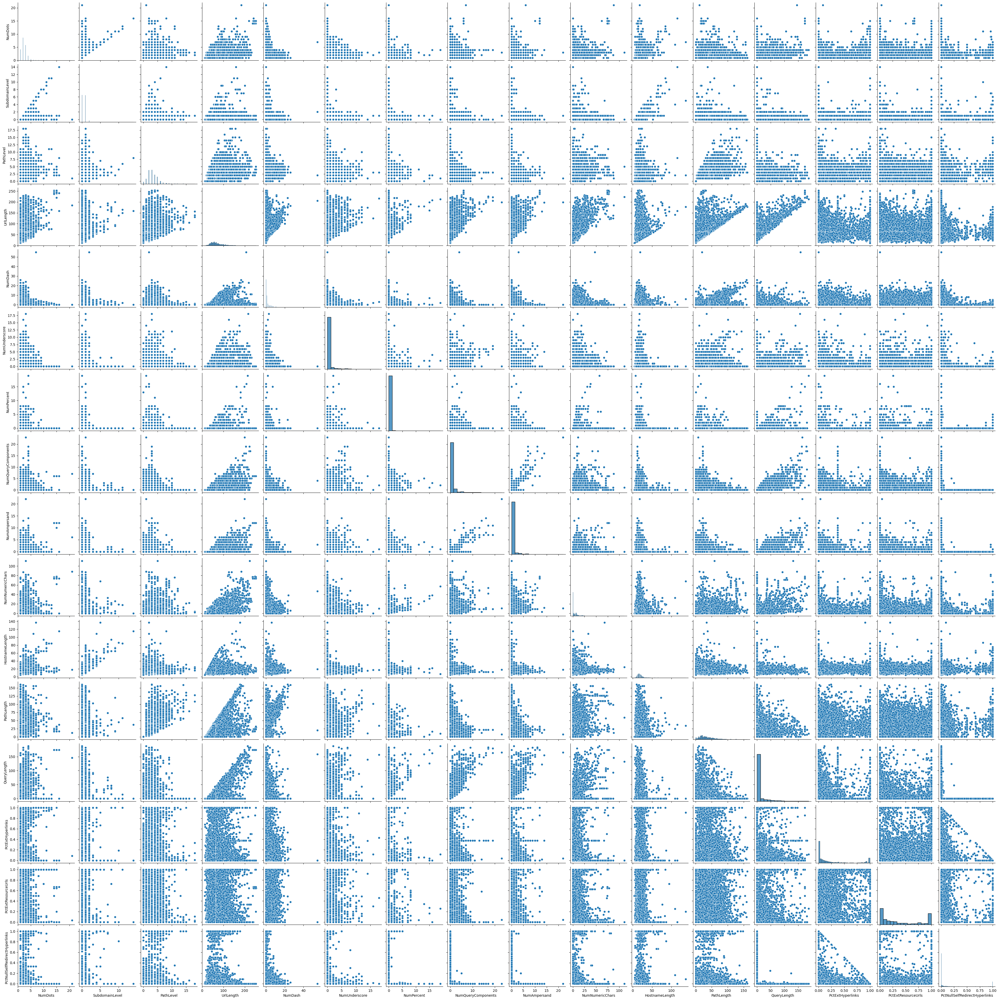

In [32]:
sns.pairplot(df[continuous_columns], size = 2.5)
plt.show()

Wow, this plot gave us insight about how the data shaped!, as you can see there are borders in shape such as triangle and square. There are also outliers which we will remove:

NumDash > 40
NumDots > 20
Let's see the correlation of our data

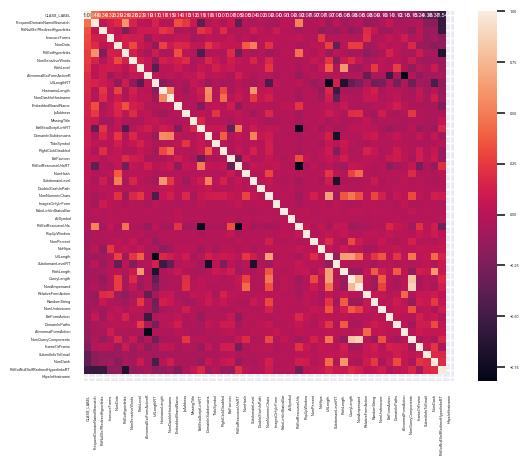

In [33]:
corr = df.corr()
cols = corr.nlargest(50, 'CLASS_LABEL')['CLASS_LABEL'].index
cm = np.corrcoef(df[cols].values.T)
sns.set_theme(font_scale=0.25)
hm = sns.heatmap(cm, cbar=True, annot=True, square=True, fmt='.2f', annot_kws={'size': 4}, yticklabels=cols.values, xticklabels=cols.values)
plt.show()

The matrix shows high variation of correlation among the variables. There's also no sign of twin variables. Next we will check outliers for the ordinal columns

In [34]:
ordinal_columns = [col for col in df.columns if col not in continuous_columns]

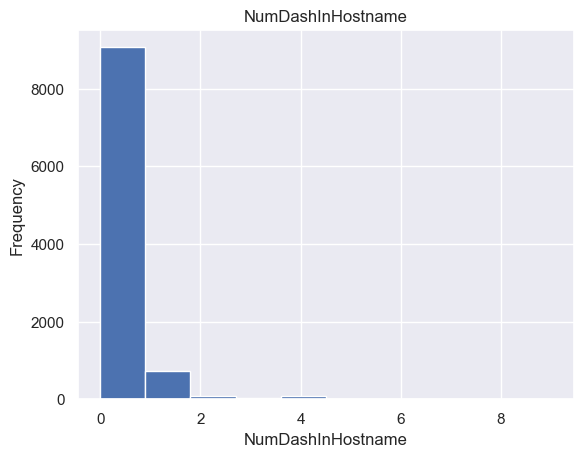

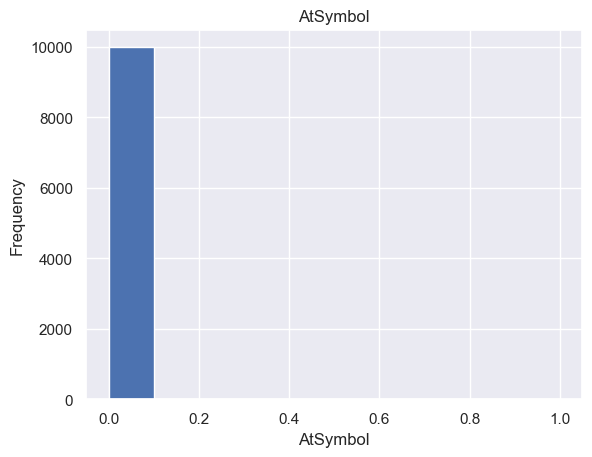

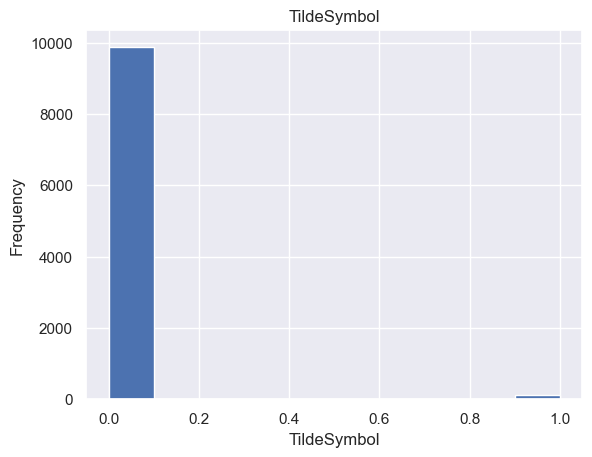

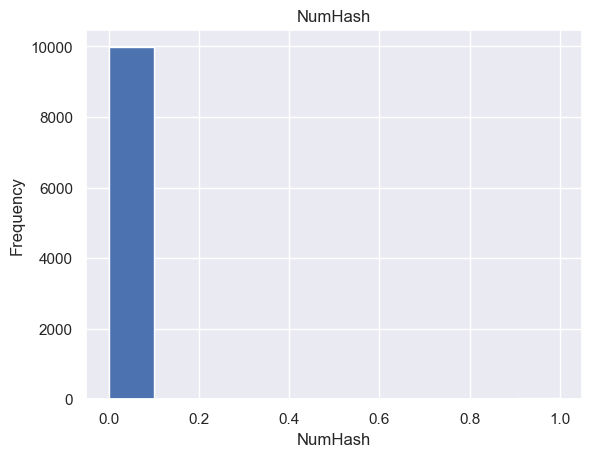

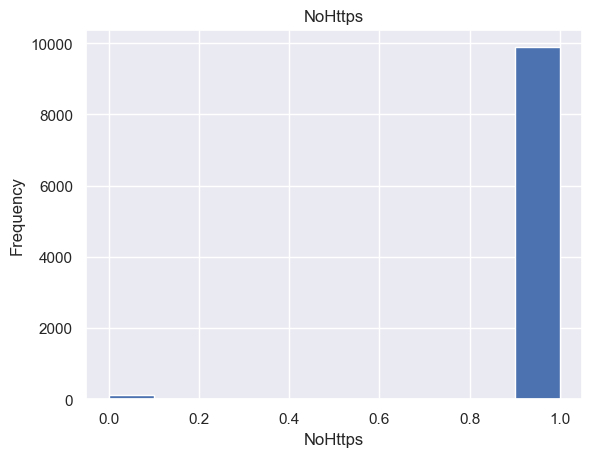

...

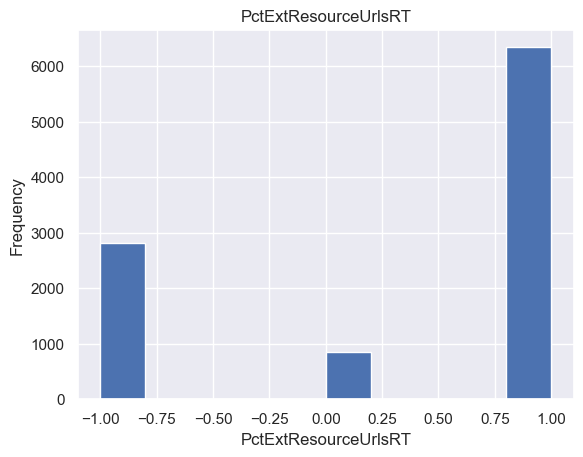

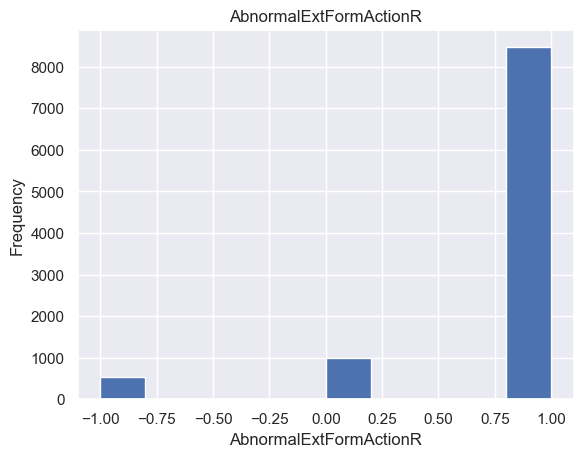

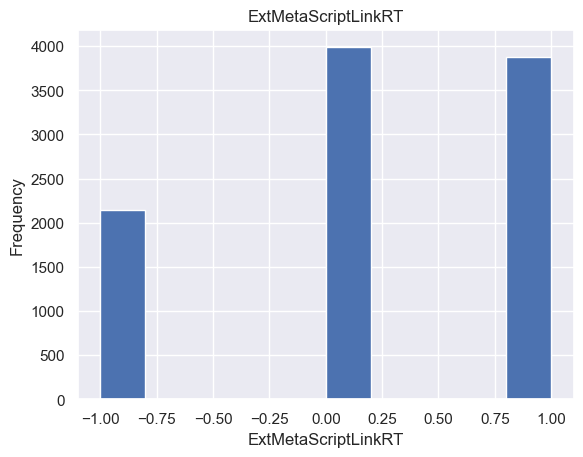

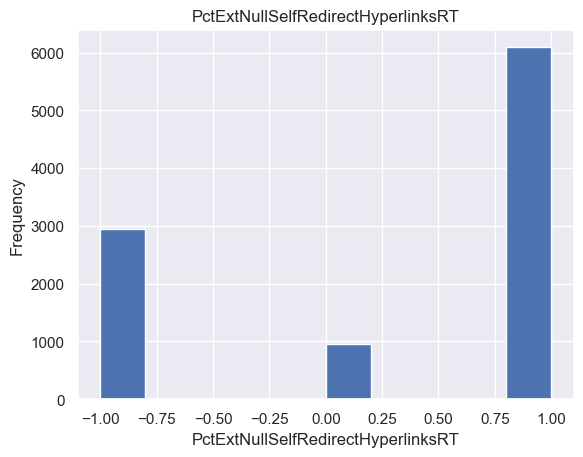

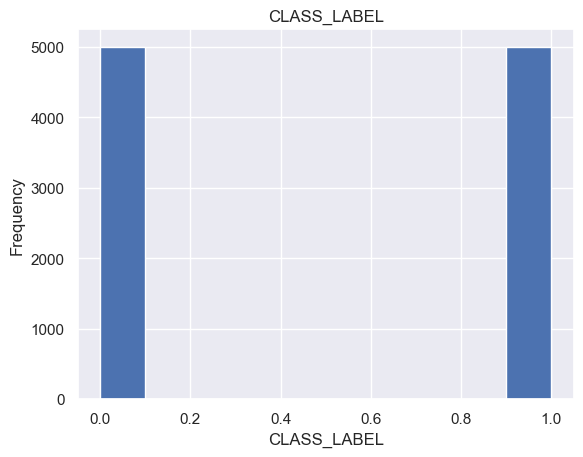

In [35]:
sns.set_theme(font_scale=1)
for col in ordinal_columns:
    plt.hist(df[col], bins=10)  
    plt.xlabel(col)
    plt.ylabel('Frequency')
    plt.title(f'{col}')
    plt.show()

All ordinal data seems in good range, we can continue checking the distribution of the continuous data

In [36]:
def normal(mean, std, color="black"):
    x = np.linspace(mean-4*std, mean+4*std, 200)
    p = stats.norm.pdf(x, mean, std)
    z = plt.plot(x, p, color, linewidth=2)


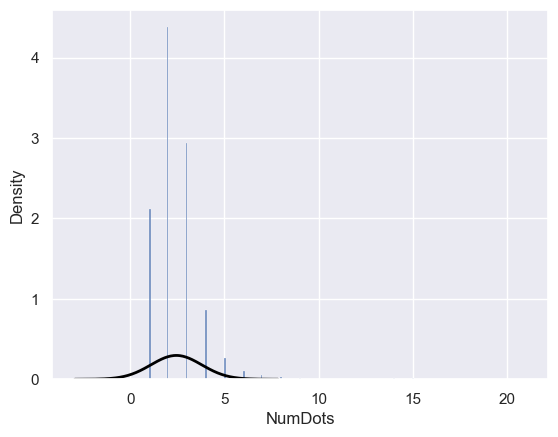

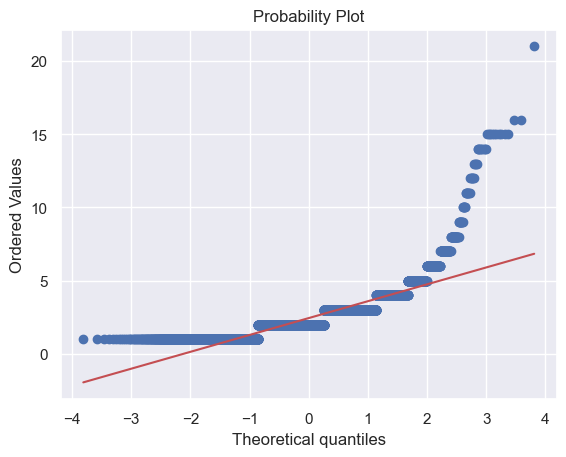

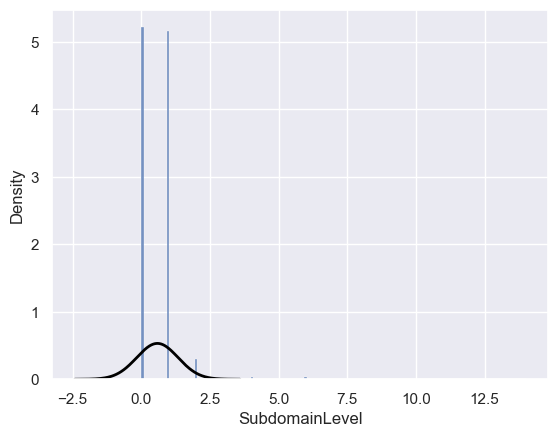

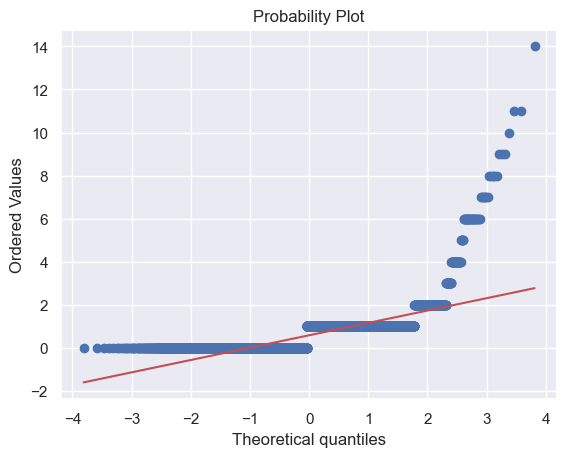

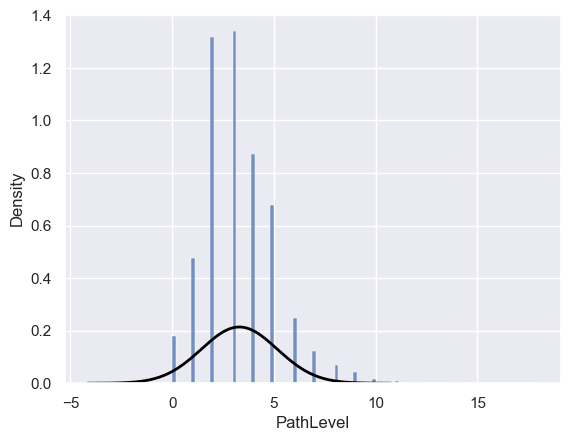

...

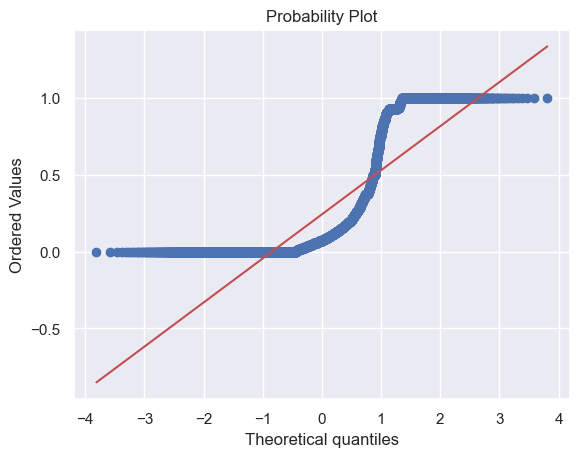

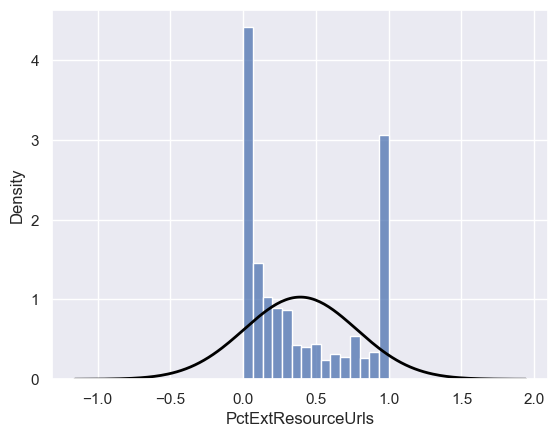

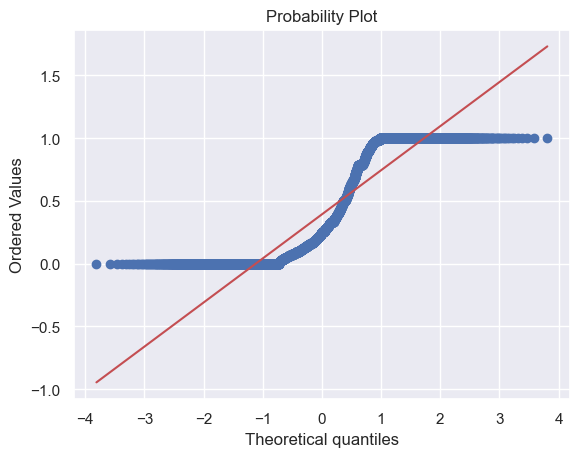

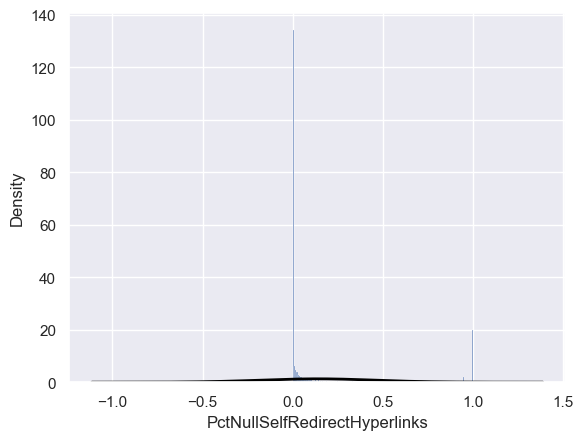

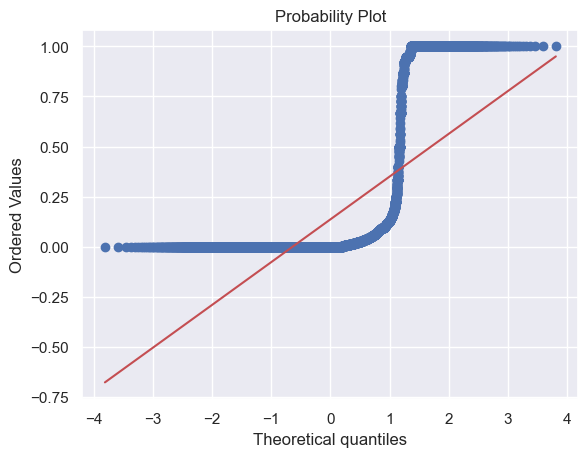

In [40]:
from scipy import stats
for col_name in continuous_columns:
    fig1, ax1 = plt.subplots()
    sns.histplot(x=df[col_name], stat="density", ax=ax1)
    normal(df[col_name].mean(), df[col_name].std())
    
    fig2, ax2 = plt.subplots()
    stats.probplot(df[col_name], plot=ax2)
    
    plt.show()

We got many positive skewness here, we will fix them in the next section which is data cleaning.

* Data Cleaning 🧹

# There are few task that we have to accompolish in this process:

* Removing Outliers
* Applying transformation to achieve normal distribution
  
# Firstly, we will remove the outliers with the condition below:

* NumDash > 40
* NumDots > 20

In [41]:
df = df[df['NumDots'] < 20]
df = df[df['NumDash'] < 40]

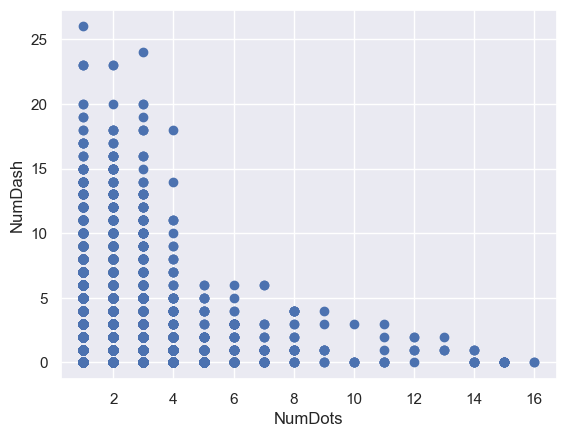

In [42]:
plt.scatter(x=df['NumDots'], y=df['NumDash'])
plt.xlabel('NumDots')
plt.ylabel('NumDash')
plt.show()

The outliers have been removed, now we will do transformation to achieve normal distribution within the continuous data.

3.7 Exploring Data

In [43]:
df.head()

,NumDots,SubdomainLevel,PathLevel,UrlLength,NumDash,NumDashInHostname,AtSymbol,TildeSymbol,NumUnderscore,NumPercent,...,IframeOrFrame,MissingTitle,ImagesOnlyInForm,SubdomainLevelRT,UrlLengthRT,PctExtResourceUrlsRT,AbnormalExtFormActionR,ExtMetaScriptLinkRT,PctExtNullSelfRedirectHyperlinksRT,CLASS_LABEL
0,3,1,5,72,0,0,0,0,0,0,...,0,0,1,1,0,1,1,-1,1,1
1,3,1,3,144,0,0,0,0,2,0,...,0,0,0,1,-1,1,1,1,1,1
2,3,1,2,58,0,0,0,0,0,0,...,0,0,0,1,0,-1,1,-1,0,1
3,3,1,6,79,1,0,0,0,0,0,...,0,0,0,1,-1,1,1,1,-1,1
4,3,0,4,46,0,0,0,0,0,0,...,1,0,0,1,1,-1,0,-1,-1,1


In [44]:
# categorical_columns
categorical_columns=df.columns[df.dtypes=="object"] # cate

In [45]:
categorical_columns

Index([], dtype='object')

In [46]:
# Numerical Columns
numerical_columns=df.columns[df.dtypes!='object']


In [23]:
numerical_columns

Index(['id', 'NumDots', 'SubdomainLevel', 'PathLevel', 'UrlLength', 'NumDash',
       'NumDashInHostname', 'AtSymbol', 'TildeSymbol', 'NumUnderscore',
       'NumPercent', 'NumQueryComponents', 'NumAmpersand', 'NumHash',
       'NumNumericChars', 'NoHttps', 'RandomString', 'IpAddress',
       'DomainInSubdomains', 'DomainInPaths', 'HttpsInHostname',
       'HostnameLength', 'PathLength', 'QueryLength', 'DoubleSlashInPath',
       'NumSensitiveWords', 'EmbeddedBrandName', 'PctExtHyperlinks',
       'PctExtResourceUrls', 'ExtFavicon', 'InsecureForms',
       'RelativeFormAction', 'ExtFormAction', 'AbnormalFormAction',
       'PctNullSelfRedirectHyperlinks', 'FrequentDomainNameMismatch',
       'FakeLinkInStatusBar', 'RightClickDisabled', 'PopUpWindow',
       'SubmitInfoToEmail', 'IframeOrFrame', 'MissingTitle',
       'ImagesOnlyInForm', 'SubdomainLevelRT', 'UrlLengthRT',
       'PctExtResourceUrlsRT', 'AbnormalExtFormActionR', 'ExtMetaScriptLinkRT',
       'PctExtNullSelfRedirectHyperl

In [47]:
# Total number of columns
print("Number of Categorical columns: ",len(categorical_columns))
print("Number of Numerical columns: ",len(numerical_columns))

Number of Categorical columns:  0
Number of Numerical columns:  49


In [48]:
df[numerical_columns].describe().T # transpose

,count,mean,std,min,25%,50%,75%,max
NumDots,9998.0,2.442789,1.333346,1.0,2.000000,2.000000,3.000000,16.0
SubdomainLevel,9998.0,0.586717,0.751133,0.0,0.000000,1.000000,1.000000,14.0
PathLevel,9998.0,3.300660,1.863240,0.0,2.000000,3.000000,4.000000,18.0
UrlLength,9998.0,70.239148,33.326175,12.0,48.000000,62.000000,84.000000,253.0
NumDash,9998.0,1.812863,3.060637,0.0,0.000000,0.000000,2.000000,26.0
NumDashInHostname,9998.0,0.138928,0.545795,0.0,0.000000,0.000000,0.000000,9.0
AtSymbol,9998.0,0.000300,0.017321,0.0,0.000000,0.000000,0.000000,1.0
TildeSymbol,9998.0,0.013103,0.113720,0.0,0.000000,0.000000,0.000000,1.0
NumUnderscore,9998.0,0.323265,1.114762,0.0,0.000000,0.000000,0.000000,18.0
NumPercent,9998.0,0.073815,0.622309,0.0,0.000000,0.000000,0.000000,19.0


In [49]:
# Finding the Unique values in columns
for col in df.columns:
  print(f"Unique values in column '{col}': {df[col].unique()}")


Unique values in column 'NumDots': [ 3  2  1  8  5  4  6 12  7 14 13 15 10 16  9 11]
Unique values in column 'SubdomainLevel': [ 1  0  7  4  2 11  3  8  6  5 14  9 10]
Unique values in column 'PathLevel': [ 5  3  2  6  4  1 10  7  9  8  0 11 13 14 15 12 18 16]
Unique values in column 'UrlLength': [ 72 144  58  79  46  42  60  30  76  64  47  61  35  73  50  59  28  32
  52  62 105  55 134  43 210 135  85  80  44  95 100 111  29  37  49  34
  53  45  65 182  39  41 142  51  48 129 184 133 120  63  57 153  67  40
 139  70 149 152  82  25 212  68  38  89  90  54 172 164 191  56  33  36
 187  69  83  74  86 123  84  92  97  98  99 104  71 126 127 132  66 136
 128 146 211  26 101  91  78  88  94 216 102 170 242  75 240 103  81 118
 116 199  24  19 162  87 119 205 165  93 121  27  31 106 140 220  77 110
 197 222 249 163 241 168 231 171 215 138 169 252  22 221 236 225 173  96
 226 219 131 112 176 107 248 115 125 114 113 190 137 141 108 158 200 150
 122 151 192 161 160 154 167 143 148 174 194 

In [50]:
# Unique values in categorical columns
for col in categorical_columns:
  print(f"Unique values in column '{col}': {df[col].unique()}")

# Unique values in numerical columns
for col in numerical_columns:
  print(f"Unique values in column '{col}': {df[col].unique()}")

Unique values in column 'NumDots': [ 3  2  1  8  5  4  6 12  7 14 13 15 10 16  9 11]
Unique values in column 'SubdomainLevel': [ 1  0  7  4  2 11  3  8  6  5 14  9 10]
Unique values in column 'PathLevel': [ 5  3  2  6  4  1 10  7  9  8  0 11 13 14 15 12 18 16]
Unique values in column 'UrlLength': [ 72 144  58  79  46  42  60  30  76  64  47  61  35  73  50  59  28  32
  52  62 105  55 134  43 210 135  85  80  44  95 100 111  29  37  49  34
  53  45  65 182  39  41 142  51  48 129 184 133 120  63  57 153  67  40
 139  70 149 152  82  25 212  68  38  89  90  54 172 164 191  56  33  36
 187  69  83  74  86 123  84  92  97  98  99 104  71 126 127 132  66 136
 128 146 211  26 101  91  78  88  94 216 102 170 242  75 240 103  81 118
 116 199  24  19 162  87 119 205 165  93 121  27  31 106 140 220  77 110
 197 222 249 163 241 168 231 171 215 138 169 252  22 221 236 225 173  96
 226 219 131 112 176 107 248 115 125 114 113 190 137 141 108 158 200 150
 122 151 192 161 160 154 167 143 148 174 194 

* According to the Data descrition, these are the meaning of the values in the data

1. 1 means legitimate
2. 0 is suspicious
3. -1 is phishing

4.  EDA :📈📊📉 (Visualization)


* Let us drop the index column because that acts as a primary key and has no significance in EDA and modelling
df = df.drop(columns=['id'])

In [ ]:
df = df.drop(columns=['id'])

In [54]:
df

,NumDots,SubdomainLevel,PathLevel,UrlLength,NumDash,NumDashInHostname,AtSymbol,TildeSymbol,NumUnderscore,NumPercent,...,IframeOrFrame,MissingTitle,ImagesOnlyInForm,SubdomainLevelRT,UrlLengthRT,PctExtResourceUrlsRT,AbnormalExtFormActionR,ExtMetaScriptLinkRT,PctExtNullSelfRedirectHyperlinksRT,CLASS_LABEL
0,3,1,5,72,0,0,0,0,0,0,...,0,0,1,1,0,1,1,-1,1,1
1,3,1,3,144,0,0,0,0,2,0,...,0,0,0,1,-1,1,1,1,1,1
2,3,1,2,58,0,0,0,0,0,0,...,0,0,0,1,0,-1,1,-1,0,1
3,3,1,6,79,1,0,0,0,0,0,...,0,0,0,1,-1,1,1,1,-1,1
4,3,0,4,46,0,0,0,0,0,0,...,1,0,0,1,1,-1,0,-1,-1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9995,3,1,1,50,0,0,0,0,0,0,...,0,0,0,1,1,-1,1,0,1,0
9996,2,1,4,59,1,0,0,0,0,0,...,1,0,0,1,0,0,1,0,1,0
9997,2,1,4,57,0,0,0,0,0,0,...,0,0,0,1,0,1,1,0,1,0
9998,3,1,1,49,0,0,0,0,0,0,...,1,0,0,1,1,0,1,0,1,0


* outliers


4.1 Visualzie  

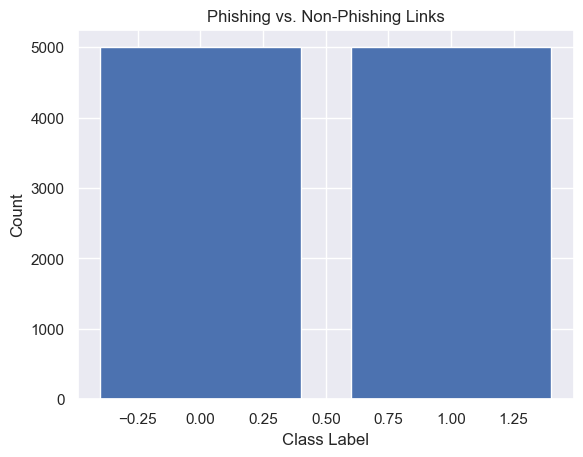

In [55]:
class_counts = df['CLASS_LABEL'].value_counts()

# Create a bar chart
plt.bar(class_counts.index, class_counts.values)

# Add labels and title
plt.xlabel('Class Label')
plt.ylabel('Count')
plt.title('Phishing vs. Non-Phishing Links')

# Add tick labels


# Display the chart
plt.show()

* Pandas Profiling


In [56]:
! pip install -U ydata-profiling

  Using cached ydata_profiling-4.9.0-py2.py3-none-any.whl.metadata (20 kB)
  Using cached pydantic-2.8.2-py3-none-any.whl.metadata (125 kB)
  Using cached visions-0.7.6-py3-none-any.whl.metadata (11 kB)
  Using cached htmlmin-0.1.12-py3-none-any.whl
  Using cached phik-0.12.4-cp311-cp311-win_amd64.whl.metadata (5.6 kB)
  Using cached multimethod-1.12-py3-none-any.whl.metadata (9.6 kB)
  Using cached typeguard-4.3.0-py3-none-any.whl.metadata (3.7 kB)
  Using cached ImageHash-4.3.1-py2.py3-none-any.whl.metadata (8.0 kB)
  Using cached wordcloud-1.9.3-cp311-cp311-win_amd64.whl.metadata (3.5 kB)
  Using cached dacite-1.8.1-py3-none-any.whl.metadata (15 kB)
  Using cached annotated_types-0.7.0-py3-none-any.whl.metadata (15 kB)
  Using cached pydantic_core-2.20.1-cp311-none-win_amd64.whl.metadata (6.7 kB)
  Using cached typing_extensions-4.12.2-py3-none-any.whl.metadata (3.0 kB)
Using cached ydata_profiling-4.9.0-py2.py3-none-any.whl (356 kB)
Using cached ImageHash-4.3.1-py2.py3-none-any.whl

In [57]:
from ydata_profiling import ProfileReport
y=ProfileReport(df)

In [58]:
y

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]